In [395]:
import torch as torch
import numpy as np
from scipy.io import loadmat
import pdb
import os
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.axes_grid1 import make_axes_locatable
#import matplotlib
#matplotlib.use('Agg')
import matplotlib.pyplot as plt
from matplotlib import cm, colors

import sys
sys.path.append("..")
from project_bones import Projection_Client

%matplotlib inline
%load_ext autoreload
%autoreload 2

#original_joint_names_dataset = ['spine3', 'spine4', 'spine2', 'spine', 'pelvis', 'neck', 'head', 'head_top',
          #           'left_clavicle', 'left_shoulder', 'left_elbow','left_wrist', 'left_hand',  
           #          'right_clavicle', 'right_shoulder', 'right_elbow', 'right_wrist', 'right_hand', 
            #         'left_hip', 'left_knee', 'left_ankle', 'left_foot', 'left_toe', 'right_hip' , 
             #        'right_knee', 'right_ankle', 'right_foot', 'right_toe'] 
original_joint_names_dataset = ['spine3', 'spine4', 'spine2', 'spine', 'pelvis', 'neck', 'head', 'head_top',
                     'left_clavicle', 'left_shoulder', 'left_elbow','left_wrist', 'left_hand',  
                    'right_clavicle', 'right_shoulder', 'right_elbow', 'right_wrist', 'right_hand', 
                    'left_hip', 'left_knee', 'left_ankle', 'left_foot', 'left_toe', 'right_hip' , 
                    'right_knee', 'right_ankle', 'right_foot', 'right_toe'] 
joint_indices_dataset = [3, 1, 4, 5, 5, 2, 6, 7, 6, 9, 10, 11, 12, 6, 14, 15, 16, 17, 5, 19, 20, 21, 22, 5, 24, 25, 26, 27 ]

joint_names_mpi = ['head','neck','right_shoulder','right_elbow','right_hand',
                'left_shoulder', 'left_elbow','left_hand','right_hip','right_knee', 
                'right_foot', 'left_hip', 'left_knee', 'left_foot', 'spine']

bones_mpi = [[0, 1], [14, 1], #middle
            [1, 2], [2, 3], [3, 4], #right arm
            [1, 5], [5, 6], [6, 7],  #left arm
            [14, 8], [8, 9], [9, 10], #right leg
            [14, 11], [11, 12], [12, 13]] #left leg


def find_bone_map():
    joint_map = []
    for ind, value in enumerate(joint_names_mpi):
        joint_map.append(original_joint_names_dataset.index(value))
    return joint_map


def rearrange_bones_to_mpi(joints_unarranged, joint_map):
    joints_rearranged = np.zeros([3,15])
    joints_rearranged = joints_unarranged[:, joint_map]
    return joints_rearranged

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [396]:
def put_poses_in_matrix(joint_map):
    #pdb.set_trace()
    camera_list_poses = internal_annot_file["annot3"]
    pose_matrix = np.zeros([14, 6031, 3, 15])
    for camera_ind in range(14):
        camera_dir = new_dataset_loc+"/camera_"+str(camera_ind)
        if not os.path.exists(camera_dir):
            os.makedirs(camera_dir)  
        poses_file = open(camera_dir+"/rel_3d_poses.txt", "w")
        camera_i = camera_list_poses[camera_ind][0] 
        anim_time = 0
        for linecount in range(camera_i.shape[0]):
            anim_time += 0.02
            flattened_pose = camera_i[linecount]
            pose = flattened_pose.reshape((3,-1), order="F")
            rearranged_pose = rearrange_bones_to_mpi(pose, joint_map)
            pose_matrix[camera_ind, linecount, :, :] = rearranged_pose.copy()
            pose_matrix[camera_ind, linecount, :, :] = pose_matrix[camera_ind, linecount, :, :] /1000
            pose_str = ""
            for i in range(rearranged_pose.shape[1]):
                pose_str += str(rearranged_pose[0, i]) + '\t' + str(rearranged_pose[1, i]) + '\t' + str(rearranged_pose[2, i])
            poses_file.write(str(anim_time)+ '\t'+ pose_str + '\n')
    return pose_matrix

In [397]:
def get_stripped_word_list(file_name):
    line = file_name.readline()
    word_list = line.split()
    stripped_word_list = [word.strip() for word in word_list]
    first_word = stripped_word_list[0]
    return first_word, stripped_word_list

In [398]:

def parse_camera_calib_file(camera_calib_file, new_dataset_loc):
    #camera_calib_file[]
    line = camera_calib_file.readline()
    first_word = ""

    cam_c = np.zeros((14, 3))
    cam_up = np.zeros((14, 3))
    cam_right = np.zeros((14, 3))

    cam_intrinsics = np.zeros((14,5))
    for cam_index in range(14):
        camera_dir = new_dataset_loc+"/camera_"+str(cam_index)
        if not os.path.exists(camera_dir):
            os.makedirs(camera_dir)  

        intrinsics_file = open(camera_dir+"/intrinsics.txt", "w")
        intrinsics_file.write("focal_length\tpx\tpy\tsize_x\tsize_y\n")
        first_word, stripped_word_list = get_stripped_word_list(camera_calib_file)
        assert first_word == "camera"
        size_x = 2048
        size_y = 2048
        while (first_word != "focalLength"):
            first_word, stripped_word_list = get_stripped_word_list(camera_calib_file)
        focal_length = float(stripped_word_list[1])*size_x/10
        while (first_word != "centerOffset"):
            first_word, stripped_word_list = get_stripped_word_list(camera_calib_file)
        px = size_x/2+float(stripped_word_list[1])*size_x/10
        py = size_y/2+float(stripped_word_list[2])*size_y/10

        cam_intrinsics[cam_index, :]= np.array([focal_length, px, py, size_x, size_y])
        intrinsics_file.write(str(focal_length)+"\t"+str(px)+"\t"+str(py)+"\t"+str(size_x)+"\t"+str(size_y))

        while (first_word != "origin"):
            first_word, stripped_word_list = get_stripped_word_list(camera_calib_file)
        cam_c[cam_index, :] = np.array([float(stripped_word_list[1]), float(stripped_word_list[2]), float(stripped_word_list[3])])
        while (first_word != "up"):
            first_word, stripped_word_list = get_stripped_word_list(camera_calib_file)
        cam_up[cam_index, :] = np.array([float(stripped_word_list[1]), float(stripped_word_list[2]), float(stripped_word_list[3])])
        while (first_word != "right"):
            first_word, stripped_word_list = get_stripped_word_list(camera_calib_file)
        cam_right[cam_index, :] = np.array([float(stripped_word_list[1]), float(stripped_word_list[2]), float(stripped_word_list[3])])

    return cam_intrinsics, cam_c, cam_up, cam_right

In [399]:
def get_camera_transformation_matrix(cam_c, cam_up, cam_right):
    camera_transformation_matrix = np.zeros([14,4,4])
    camera_transformation_matrix_inv =  np.zeros([14,4,4])
    flip_y_z = np.array([[1,0,0],[0,0,1],[0,1,0]])

    for cam_index in range(14):
        camera_transformation_matrix[cam_index, 3, :] = np.array([0,0,0,1]) 
        camera_transformation_matrix[cam_index, 0:3, 3] = cam_c[cam_index, :]/1000
        
        vec_forward = np.cross(cam_up[cam_index, :], cam_right[cam_index, :])

        camera_transformation_matrix[cam_index, 0:3, 0] = cam_right[cam_index, :]
        camera_transformation_matrix[cam_index, 0:3, 2] = vec_forward
        camera_transformation_matrix[cam_index, 0:3, 1] = -cam_up[cam_index, :]
        
        camera_transformation_matrix[cam_index, 0:3, :] = flip_y_z@camera_transformation_matrix[cam_index, 0:3, :]
        camera_transformation_matrix_inv[cam_index, :, :] = np.linalg.inv(camera_transformation_matrix[cam_index, :, :])

    return camera_transformation_matrix, camera_transformation_matrix_inv

In [400]:
def record_camera_poses(new_dataset_loc, cam_c, cam_up, cam_right):
    camera_poses_file = open(new_dataset_loc+"/camera_poses.txt", "w")

    camera_transformation_matrix,camera_transformation_matrix_inv = get_camera_transformation_matrix(cam_c, cam_up, cam_right)
    for cam_index in range(14):
        flattened_cam_matrix = np.reshape(camera_transformation_matrix[cam_index, :], (16,-1))
        cam_str = str(cam_index)+'\t'
        for i in range(16):
            cam_str += str(flattened_cam_matrix[i][0]) +'\t'
        camera_poses_file.write(cam_str+'\n')
    return camera_transformation_matrix,  camera_transformation_matrix_inv

In [401]:
def transform_camera_coord_to_world_coord(camera_pose_matrix, camera_transformation_matrix, projection_client):
    camera_transformation_matrix_torch = torch.from_numpy(camera_transformation_matrix).float()
    pose_gt_3d = torch.zeros(camera_pose_matrix.shape[1], 3, 15)
    for linecount in range(camera_pose_matrix.shape[1]):
        pose_for_all_cams = camera_pose_matrix[:,linecount,:,:]
        pose_for_all_cams_torch = torch.from_numpy(pose_for_all_cams).float()
        transformed_poses = projection_client.camera_to_world(pose_for_all_cams_torch, camera_transformation_matrix_torch)
        pose_gt_3d[linecount, :, :] = torch.mean(transformed_poses, dim=0)
        print(torch.mean(torch.std(transformed_poses, dim=0)))
    print(transformed_poses[:, :, 0])
    return pose_gt_3d.numpy()
    

In [402]:
def save_poses(pose_matrix, new_dataset_loc):
    poses_file = open(new_dataset_loc+"/gt_3d_poses.txt", "w")
    anim_time = 0
    for i in range(pose_matrix.shape[0]):
        anim_time += 0.02
        pose_str = ""
        for j in range(pose_matrix.shape[1]):
            pose_str += str(pose_matrix[i, 0, j]) + '\t' + str(pose_matrix[i, 1, j]) + '\t' + str(pose_matrix[i, 2, j])
        poses_file.write(str(anim_time)+ '\t'+ pose_str + '\n')

In [403]:
def read_image(dataset_loc, camera, frame):
    image_folder = dataset_loc + "/imageSequence"
    image_dir = (image_folder + "/img_{:d}_{:06d}.jpg").format(camera, frame)
    image = plt.imread(image_dir)
    return image

## Plotting Functions

In [404]:
def display_image(image):
    fig = plt.figure()
    plt.imshow(image)
    plt.show()
    plt.close()
    

In [405]:
def display_pose(pose):
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111,  projection='3d')
    X = pose[0,:]
    Y = pose[1,:]
    Z = pose[2,:]
    for _, bone in enumerate(bones_mpi):
        ax.plot(X[bone], Y[bone], Z[bone], c='xkcd:black')

    max_range = np.array([X.max()-X.min(), Y.max()-Y.min(), Z.max()-Z.min()]).max() *0.4
    mid_x = (X.max()+X.min()) * 0.5
    mid_y = (Y.max()+Y.min()) * 0.5
    mid_z = (Z.max()+Z.min()) * 0.5
    
    ax.set_xlim(mid_x - max_range, mid_x + max_range)
    ax.set_ylim(mid_y - max_range, mid_y + max_range)
    ax.set_zlim(mid_z - max_range, mid_z + max_range)
    
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    
    plt.show()
    plt.close(fig)

In [406]:
def plot_all_camera_pos(tranformation_matrix_all, pose=None):
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111,  projection='3d')

    X, Y, Z = [], [], []
    if pose is not None:
        X = pose[0,:].tolist()
        Y = pose[1,:].tolist()
        Z = pose[2,:].tolist()
        for _, bone in enumerate(bones_mpi):
            ax.plot(pose[0,bone], pose[1,bone], pose[2,bone], c='xkcd:black')

    for camera_ind in range(tranformation_matrix_all.shape[0]):
        transformation_matrix = tranformation_matrix_all[camera_ind, :, :]
        C_drone = transformation_matrix[0:3, 3]
       # C_drone[2] = C_drone[2] 
        R_drone = transformation_matrix[0:3, 0:3]
        axis1 = R_drone[:,2].unsqueeze(1)# @torch.t(torch.FloatTensor([[0,0,1]]))
        axis2 = R_drone[:,1].unsqueeze(1)#@torch.t(torch.FloatTensor([[0,1,0]]))
        axis3 = R_drone[:,0].unsqueeze(1)#@torch.t(torch.FloatTensor([[1,0,0]]))

        axis1 = 1*axis1/torch.norm(axis1)
        axis2 = 1*axis2/torch.norm(axis2)
        axis3 = 1*axis3/torch.norm(axis3)

        ax.scatter(C_drone[0], C_drone[1], C_drone[2], c='xkcd:pink')
        p1, = ax.plot([C_drone[0], C_drone[0]+axis1[0,0]], [C_drone[1], C_drone[1]+axis1[1,0]], [C_drone[2], C_drone[2]+axis1[2,0]], c='xkcd:red', label="forward")
        p2, =ax.plot([C_drone[0], C_drone[0]+axis2[0,0]], [C_drone[1], C_drone[1]+axis2[1,0]], [C_drone[2], C_drone[2]+axis2[2,0]], c='xkcd:blue', label="-up")
        p3, = ax.plot([C_drone[0], C_drone[0]+axis3[0,0]], [C_drone[1], C_drone[1]+axis3[1,0]], [C_drone[2], C_drone[2]+axis3[2,0]], c='xkcd:green', label="right")
        ax.text(C_drone[0], C_drone[1], C_drone[2], str(camera_ind))

        X.append(C_drone[0])
        Y.append(C_drone[1])
        Z.append(C_drone[2])

        ax.legend([p1, p2, p3])

    X = np.array(X)
    Y = np.array(Y)
    Z = np.array(Z)

    max_range = np.array([X.max()-X.min(), Y.max()-Y.min(), Z.max()-Z.min()]).max() *0.4
    mid_x = (X.max()+X.min()) * 0.5
    mid_y = (Y.max()+Y.min()) * 0.5
    mid_z = (Z.max()+Z.min()) * 0.5
    ax.set_xlim(mid_x - max_range, mid_x + max_range)
    ax.set_ylim(mid_y - max_range, mid_y + max_range)
    ax.set_zlim(mid_z - max_range, mid_z + max_range)
    #ax.view_init(elev=30., azim=135)
    #plt.show()
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    
    ax.view_init(elev=4., azim=135)
    plt.show()
  #  plt.show()
   # plt.close(fig)

In [407]:
def plot_for_all_views(dataset_loc, frame):
    fig = plt.figure(figsize=(50,50))
    for i in range(14):
        fig.add_subplot(4,4,int(i+1))
        image = read_image(dataset_loc, i, frame)
        plt.imshow(image)
    plt.show()
    plt.close()

In [408]:
def plot_for_all_views_proj(dataset_loc, frame, proj):
    fig = plt.figure(figsize=(50,50))
    for camera_ind in range(14):
        ax = fig.add_subplot(4,4,int(camera_ind+1))
        image = read_image(dataset_loc, camera_ind, frame)
        ax.imshow(image)
        for i, bone in enumerate(bones_mpi):    
            ax.plot(proj[camera_ind, 0, bone], proj[camera_ind, 1, bone], color = "w", linewidth=1)   

    plt.show()
    plt.close()

# Process Dataset

In [409]:
dataset_loc = "/Users/kicirogl/workspace/cvlabdata1/home/rhodin/datasets/MPI-3D-HP-allcam/sotnychenko_seq_1"
new_dataset_loc = "/Users/kicirogl/workspace/cvlabdata2/home/kicirogl/ActiveDrone/test_sets/mpi_inf_3dhp"
test_set_name = "mpi_inf_3dhp"

internal_annot_file = loadmat(dataset_loc+"/internal_annot.mat")

In [410]:
joint_map = find_bone_map()
camera_pose_matrix = put_poses_in_matrix(joint_map)

In [411]:
camera_calib_file = open(dataset_loc+"/cameras.calib", "r")
cam_intrinsics, cam_c, cam_up, cam_right = parse_camera_calib_file(camera_calib_file, new_dataset_loc)

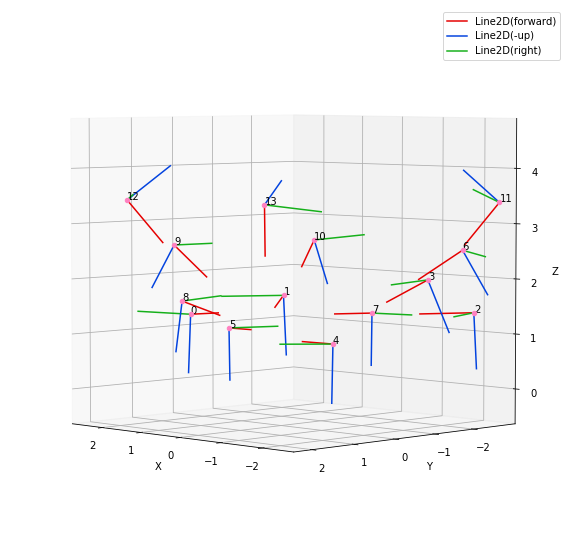

In [412]:
camera_transformation_matrix, camera_transformation_matrix_inv = record_camera_poses(new_dataset_loc, cam_c, cam_up, cam_right)
plot_all_camera_pos(torch.from_numpy(camera_transformation_matrix).float())

In [413]:
projection_client = Projection_Client(test_set=test_set_name, future_window_size=0, num_of_joints=15, 
                    intrinsics=cam_intrinsics, noise_2d_std=0, device=torch.device("cpu"))    
poses_3d_gt = transform_camera_coord_to_world_coord(camera_pose_matrix, camera_transformation_matrix, projection_client)
#print(poses_3d_gt[0:10,:,:])
for linecount in range(1000,1200, 10):
    #display_pose(poses_3d_gt.numpy()[linecount,:,:])
    pass

tensor(2.6985e-06)
tensor(2.6985e-06)
tensor(2.6985e-06)
tensor(2.8009e-06)
tensor(2.6502e-06)
tensor(2.6981e-06)
tensor(2.6698e-06)
tensor(2.6482e-06)
tensor(2.5859e-06)
tensor(2.7370e-06)
tensor(2.7168e-06)
tensor(2.7113e-06)
tensor(2.6290e-06)
tensor(2.6135e-06)
tensor(2.7206e-06)
tensor(2.6975e-06)
tensor(2.7288e-06)
tensor(2.6702e-06)
tensor(2.6419e-06)
tensor(2.7076e-06)
tensor(2.7115e-06)
tensor(2.7300e-06)
tensor(2.6635e-06)
tensor(2.7139e-06)
tensor(2.7210e-06)
tensor(2.7054e-06)
tensor(2.6869e-06)
tensor(2.6714e-06)
tensor(2.6711e-06)
tensor(2.6165e-06)
tensor(2.6780e-06)
tensor(2.7169e-06)
tensor(2.6853e-06)
tensor(2.7445e-06)
tensor(2.7216e-06)
tensor(2.7205e-06)
tensor(2.6338e-06)
tensor(2.7866e-06)
tensor(2.7391e-06)
tensor(2.7213e-06)
tensor(2.7304e-06)
tensor(2.6573e-06)
tensor(2.6620e-06)
tensor(2.6514e-06)
tensor(2.6124e-06)
tensor(2.6260e-06)
tensor(2.7528e-06)
tensor(2.6335e-06)
tensor(2.6840e-06)
tensor(2.6807e-06)
tensor(2.7650e-06)
tensor(2.5200e-06)
tensor(2.806

tensor(2.3517e-06)
tensor(2.3404e-06)
tensor(2.3028e-06)
tensor(2.3635e-06)
tensor(2.4177e-06)
tensor(2.3954e-06)
tensor(2.3328e-06)
tensor(2.3786e-06)
tensor(2.3676e-06)
tensor(2.3636e-06)
tensor(2.3330e-06)
tensor(2.3054e-06)
tensor(2.3159e-06)
tensor(2.3532e-06)
tensor(2.2886e-06)
tensor(2.2770e-06)
tensor(2.3487e-06)
tensor(2.4134e-06)
tensor(2.2937e-06)
tensor(2.4250e-06)
tensor(2.3205e-06)
tensor(2.4272e-06)
tensor(2.3934e-06)
tensor(2.2355e-06)
tensor(2.4629e-06)
tensor(2.4257e-06)
tensor(2.3543e-06)
tensor(2.2799e-06)
tensor(2.3986e-06)
tensor(2.6859e-06)
tensor(2.4215e-06)
tensor(2.5367e-06)
tensor(2.5104e-06)
tensor(2.3577e-06)
tensor(2.3870e-06)
tensor(2.4361e-06)
tensor(2.4005e-06)
tensor(2.4929e-06)
tensor(2.5090e-06)
tensor(2.5485e-06)
tensor(2.4718e-06)
tensor(2.4067e-06)
tensor(2.5418e-06)
tensor(2.4124e-06)
tensor(2.6283e-06)
tensor(2.4796e-06)
tensor(2.4569e-06)
tensor(2.5383e-06)
tensor(2.4350e-06)
tensor(2.5043e-06)
tensor(2.4914e-06)
tensor(2.5270e-06)
tensor(2.539

tensor(2.4123e-06)
tensor(2.4386e-06)
tensor(2.4454e-06)
tensor(2.5716e-06)
tensor(2.4198e-06)
tensor(2.5222e-06)
tensor(2.4504e-06)
tensor(2.4744e-06)
tensor(2.3818e-06)
tensor(2.5284e-06)
tensor(2.5781e-06)
tensor(2.4704e-06)
tensor(2.4326e-06)
tensor(2.3813e-06)
tensor(2.4604e-06)
tensor(2.4759e-06)
tensor(2.5391e-06)
tensor(2.4720e-06)
tensor(2.5288e-06)
tensor(2.4095e-06)
tensor(2.5058e-06)
tensor(2.4741e-06)
tensor(2.4841e-06)
tensor(2.4907e-06)
tensor(2.4525e-06)
tensor(2.5539e-06)
tensor(2.5668e-06)
tensor(2.3719e-06)
tensor(2.5052e-06)
tensor(2.5670e-06)
tensor(2.5444e-06)
tensor(2.4871e-06)
tensor(2.5246e-06)
tensor(2.3457e-06)
tensor(2.5231e-06)
tensor(2.5316e-06)
tensor(2.5957e-06)
tensor(2.4572e-06)
tensor(2.5063e-06)
tensor(2.5711e-06)
tensor(2.4015e-06)
tensor(2.5260e-06)
tensor(2.4640e-06)
tensor(2.3684e-06)
tensor(2.3770e-06)
tensor(2.3080e-06)
tensor(2.4434e-06)
tensor(2.4468e-06)
tensor(2.4165e-06)
tensor(2.3992e-06)
tensor(2.5052e-06)
tensor(2.3478e-06)
tensor(2.535

tensor(2.4403e-06)
tensor(2.4106e-06)
tensor(2.3617e-06)
tensor(2.4167e-06)
tensor(2.3924e-06)
tensor(2.3828e-06)
tensor(2.4525e-06)
tensor(2.4282e-06)
tensor(2.3751e-06)
tensor(2.3309e-06)
tensor(2.3538e-06)
tensor(2.3602e-06)
tensor(2.3659e-06)
tensor(2.3175e-06)
tensor(2.2826e-06)
tensor(2.2667e-06)
tensor(2.2691e-06)
tensor(2.3802e-06)
tensor(2.2687e-06)
tensor(2.3064e-06)
tensor(2.2626e-06)
tensor(2.2192e-06)
tensor(2.1982e-06)
tensor(2.2008e-06)
tensor(2.1163e-06)
tensor(2.1967e-06)
tensor(2.0598e-06)
tensor(2.1524e-06)
tensor(2.0811e-06)
tensor(2.1778e-06)
tensor(2.1443e-06)
tensor(2.0637e-06)
tensor(2.1343e-06)
tensor(1.9737e-06)
tensor(2.2819e-06)
tensor(2.1858e-06)
tensor(2.1141e-06)
tensor(2.0544e-06)
tensor(2.0654e-06)
tensor(1.9906e-06)
tensor(2.0126e-06)
tensor(1.9681e-06)
tensor(2.0804e-06)
tensor(2.0470e-06)
tensor(2.0317e-06)
tensor(2.0148e-06)
tensor(2.0679e-06)
tensor(2.0533e-06)
tensor(2.0425e-06)
tensor(2.0125e-06)
tensor(1.8697e-06)
tensor(2.0819e-06)
tensor(2.090

tensor(2.1151e-06)
tensor(2.0665e-06)
tensor(2.0522e-06)
tensor(2.1965e-06)
tensor(2.0597e-06)
tensor(2.1430e-06)
tensor(2.0720e-06)
tensor(2.0390e-06)
tensor(2.0405e-06)
tensor(1.9625e-06)
tensor(2.0061e-06)
tensor(2.1526e-06)
tensor(2.0358e-06)
tensor(2.1706e-06)
tensor(1.9496e-06)
tensor(2.1074e-06)
tensor(1.8978e-06)
tensor(1.9467e-06)
tensor(1.9681e-06)
tensor(2.1013e-06)
tensor(1.9482e-06)
tensor(1.9967e-06)
tensor(1.9574e-06)
tensor(2.0989e-06)
tensor(2.0360e-06)
tensor(1.8858e-06)
tensor(2.1428e-06)
tensor(2.1199e-06)
tensor(2.1031e-06)
tensor(2.1539e-06)
tensor(1.9185e-06)
tensor(2.0892e-06)
tensor(2.0386e-06)
tensor(1.9949e-06)
tensor(1.9866e-06)
tensor(2.0727e-06)
tensor(2.0960e-06)
tensor(1.9962e-06)
tensor(1.9967e-06)
tensor(1.9775e-06)
tensor(2.1041e-06)
tensor(2.1143e-06)
tensor(1.9912e-06)
tensor(2.0314e-06)
tensor(2.0129e-06)
tensor(2.1048e-06)
tensor(1.9907e-06)
tensor(2.0992e-06)
tensor(2.0715e-06)
tensor(2.0217e-06)
tensor(2.0522e-06)
tensor(2.0958e-06)
tensor(2.159

tensor(2.2131e-06)
tensor(2.1049e-06)
tensor(2.0739e-06)
tensor(2.1279e-06)
tensor(2.1673e-06)
tensor(2.1312e-06)
tensor(2.0426e-06)
tensor(2.0926e-06)
tensor(2.0505e-06)
tensor(2.1100e-06)
tensor(2.1256e-06)
tensor(2.1425e-06)
tensor(2.2610e-06)
tensor(2.1129e-06)
tensor(2.1636e-06)
tensor(2.0485e-06)
tensor(2.1102e-06)
tensor(1.9984e-06)
tensor(2.1849e-06)
tensor(2.0583e-06)
tensor(2.1248e-06)
tensor(2.1418e-06)
tensor(2.1192e-06)
tensor(2.0322e-06)
tensor(2.1785e-06)
tensor(2.1403e-06)
tensor(2.1252e-06)
tensor(2.0652e-06)
tensor(2.0233e-06)
tensor(2.1243e-06)
tensor(2.1114e-06)
tensor(2.1848e-06)
tensor(2.1642e-06)
tensor(2.1214e-06)
tensor(2.0671e-06)
tensor(2.1764e-06)
tensor(2.0923e-06)
tensor(2.1113e-06)
tensor(2.1271e-06)
tensor(2.1581e-06)
tensor(2.1149e-06)
tensor(2.1761e-06)
tensor(2.2455e-06)
tensor(2.1620e-06)
tensor(2.2200e-06)
tensor(2.1159e-06)
tensor(2.2479e-06)
tensor(1.9549e-06)
tensor(2.0061e-06)
tensor(2.1102e-06)
tensor(2.2098e-06)
tensor(2.1962e-06)
tensor(2.248

tensor(1.9912e-06)
tensor(2.1696e-06)
tensor(2.0368e-06)
tensor(2.0141e-06)
tensor(2.0085e-06)
tensor(2.0897e-06)
tensor(2.0322e-06)
tensor(1.9674e-06)
tensor(2.0704e-06)
tensor(2.1174e-06)
tensor(2.0575e-06)
tensor(2.1073e-06)
tensor(2.0496e-06)
tensor(2.0736e-06)
tensor(2.0162e-06)
tensor(1.9375e-06)
tensor(2.0297e-06)
tensor(2.0617e-06)
tensor(2.1030e-06)
tensor(2.1141e-06)
tensor(2.0853e-06)
tensor(2.1042e-06)
tensor(2.0757e-06)
tensor(2.1836e-06)
tensor(2.2672e-06)
tensor(2.1840e-06)
tensor(2.1907e-06)
tensor(2.1442e-06)
tensor(2.1882e-06)
tensor(2.1738e-06)
tensor(2.1381e-06)
tensor(2.1392e-06)
tensor(2.1394e-06)
tensor(2.1316e-06)
tensor(2.0918e-06)
tensor(2.1662e-06)
tensor(2.2724e-06)
tensor(2.0416e-06)
tensor(2.0500e-06)
tensor(2.1468e-06)
tensor(2.0775e-06)
tensor(2.1473e-06)
tensor(2.0475e-06)
tensor(2.0729e-06)
tensor(2.0904e-06)
tensor(2.0538e-06)
tensor(2.0711e-06)
tensor(2.1504e-06)
tensor(2.1200e-06)
tensor(2.0927e-06)
tensor(2.0835e-06)
tensor(2.2182e-06)
tensor(2.111

tensor(2.7732e-06)
tensor(2.6342e-06)
tensor(2.6538e-06)
tensor(2.5243e-06)
tensor(2.6629e-06)
tensor(2.6585e-06)
tensor(2.8017e-06)
tensor(2.6493e-06)
tensor(2.5781e-06)
tensor(2.8432e-06)
tensor(2.5028e-06)
tensor(2.5815e-06)
tensor(2.5762e-06)
tensor(2.5721e-06)
tensor(2.5785e-06)
tensor(2.6522e-06)
tensor(2.6051e-06)
tensor(2.6827e-06)
tensor(2.6821e-06)
tensor(2.6766e-06)
tensor(2.6869e-06)
tensor(2.6410e-06)
tensor(2.6229e-06)
tensor(2.5192e-06)
tensor(2.7267e-06)
tensor(2.6740e-06)
tensor(2.6924e-06)
tensor(2.7185e-06)
tensor(2.8272e-06)
tensor(2.6914e-06)
tensor(2.5703e-06)
tensor(2.7104e-06)
tensor(2.5047e-06)
tensor(2.6385e-06)
tensor(2.7502e-06)
tensor(2.7388e-06)
tensor(2.6583e-06)
tensor(2.5398e-06)
tensor(2.6727e-06)
tensor(2.6038e-06)
tensor(2.7666e-06)
tensor(2.7254e-06)
tensor(2.6486e-06)
tensor(2.5901e-06)
tensor(2.6747e-06)
tensor(2.5390e-06)
tensor(2.5811e-06)
tensor(2.5657e-06)
tensor(2.6541e-06)
tensor(2.6200e-06)
tensor(2.5616e-06)
tensor(2.5495e-06)
tensor(2.534

tensor(2.2538e-06)
tensor(2.1427e-06)
tensor(2.2602e-06)
tensor(2.1632e-06)
tensor(2.2208e-06)
tensor(2.2296e-06)
tensor(2.0994e-06)
tensor(2.2089e-06)
tensor(2.1898e-06)
tensor(2.2733e-06)
tensor(2.1523e-06)
tensor(2.3510e-06)
tensor(2.2811e-06)
tensor(2.2293e-06)
tensor(2.2051e-06)
tensor(2.2760e-06)
tensor(2.2917e-06)
tensor(2.2904e-06)
tensor(2.2085e-06)
tensor(2.3536e-06)
tensor(2.2491e-06)
tensor(2.3665e-06)
tensor(2.2637e-06)
tensor(2.3355e-06)
tensor(2.4202e-06)
tensor(2.3338e-06)
tensor(2.3380e-06)
tensor(2.3599e-06)
tensor(2.3419e-06)
tensor(2.5124e-06)
tensor(2.3164e-06)
tensor(2.4835e-06)
tensor(2.3497e-06)
tensor(2.3320e-06)
tensor(2.4766e-06)
tensor(2.3856e-06)
tensor(2.3718e-06)
tensor(2.5319e-06)
tensor(2.4078e-06)
tensor(2.3211e-06)
tensor(2.4731e-06)
tensor(2.4484e-06)
tensor(2.4679e-06)
tensor(2.4942e-06)
tensor(2.2527e-06)
tensor(2.3900e-06)
tensor(2.3485e-06)
tensor(2.3822e-06)
tensor(2.3539e-06)
tensor(2.2235e-06)
tensor(2.3543e-06)
tensor(2.2735e-06)
tensor(2.174

tensor(2.1393e-06)
tensor(2.1652e-06)
tensor(2.1738e-06)
tensor(2.0638e-06)
tensor(2.1539e-06)
tensor(2.1039e-06)
tensor(2.1132e-06)
tensor(2.1486e-06)
tensor(2.1648e-06)
tensor(1.9850e-06)
tensor(2.2158e-06)
tensor(2.0172e-06)
tensor(2.0370e-06)
tensor(2.0725e-06)
tensor(2.1010e-06)
tensor(2.0261e-06)
tensor(2.1315e-06)
tensor(2.0273e-06)
tensor(2.0990e-06)
tensor(2.0158e-06)
tensor(2.2205e-06)
tensor(1.9787e-06)
tensor(2.0661e-06)
tensor(2.1535e-06)
tensor(2.0673e-06)
tensor(2.1063e-06)
tensor(2.0717e-06)
tensor(2.1915e-06)
tensor(2.0341e-06)
tensor(2.0595e-06)
tensor(2.1991e-06)
tensor(2.0911e-06)
tensor(2.2632e-06)
tensor(2.1284e-06)
tensor(2.1223e-06)
tensor(2.1330e-06)
tensor(2.0865e-06)
tensor(2.0861e-06)
tensor(2.1417e-06)
tensor(2.0178e-06)
tensor(2.0121e-06)
tensor(2.2267e-06)
tensor(1.9967e-06)
tensor(2.0043e-06)
tensor(2.0603e-06)
tensor(2.0551e-06)
tensor(1.9769e-06)
tensor(2.0085e-06)
tensor(2.0649e-06)
tensor(2.0752e-06)
tensor(2.0379e-06)
tensor(2.0140e-06)
tensor(2.005

tensor(2.5912e-06)
tensor(2.6799e-06)
tensor(2.6756e-06)
tensor(2.5368e-06)
tensor(2.5219e-06)
tensor(2.5740e-06)
tensor(2.5159e-06)
tensor(2.7089e-06)
tensor(2.7160e-06)
tensor(2.7577e-06)
tensor(2.6663e-06)
tensor(2.6091e-06)
tensor(2.5925e-06)
tensor(2.6891e-06)
tensor(2.7009e-06)
tensor(2.4895e-06)
tensor(2.6178e-06)
tensor(2.5203e-06)
tensor(2.5125e-06)
tensor(2.5630e-06)
tensor(2.7355e-06)
tensor(2.5043e-06)
tensor(2.4880e-06)
tensor(2.5573e-06)
tensor(2.4368e-06)
tensor(2.5129e-06)
tensor(2.4522e-06)
tensor(2.4760e-06)
tensor(2.4547e-06)
tensor(2.3977e-06)
tensor(2.3535e-06)
tensor(2.2503e-06)
tensor(2.2968e-06)
tensor(2.4109e-06)
tensor(2.2889e-06)
tensor(2.2564e-06)
tensor(2.2149e-06)
tensor(2.3360e-06)
tensor(2.1596e-06)
tensor(2.2578e-06)
tensor(2.1897e-06)
tensor(2.3153e-06)
tensor(2.1763e-06)
tensor(2.2528e-06)
tensor(2.2335e-06)
tensor(2.2409e-06)
tensor(2.1884e-06)
tensor(2.0783e-06)
tensor(2.1561e-06)
tensor(2.0142e-06)
tensor(2.0903e-06)
tensor(2.0447e-06)
tensor(2.153

tensor(2.2623e-06)
tensor(2.3752e-06)
tensor(2.3189e-06)
tensor(2.3851e-06)
tensor(2.4223e-06)
tensor(2.3328e-06)
tensor(2.3259e-06)
tensor(2.3261e-06)
tensor(2.3148e-06)
tensor(2.3032e-06)
tensor(2.3714e-06)
tensor(2.3641e-06)
tensor(2.4357e-06)
tensor(2.2544e-06)
tensor(2.4452e-06)
tensor(2.1819e-06)
tensor(2.3203e-06)
tensor(2.3937e-06)
tensor(2.4875e-06)
tensor(2.3570e-06)
tensor(2.3263e-06)
tensor(2.3587e-06)
tensor(2.5343e-06)
tensor(2.4500e-06)
tensor(2.3313e-06)
tensor(2.3373e-06)
tensor(2.2806e-06)
tensor(2.4044e-06)
tensor(2.3808e-06)
tensor(2.2926e-06)
tensor(2.4839e-06)
tensor(2.3475e-06)
tensor(2.3959e-06)
tensor(2.4138e-06)
tensor(2.2540e-06)
tensor(2.1730e-06)
tensor(2.4517e-06)
tensor(2.4368e-06)
tensor(2.4410e-06)
tensor(2.2774e-06)
tensor(2.2543e-06)
tensor(2.4740e-06)
tensor(2.4550e-06)
tensor(2.4547e-06)
tensor(2.3562e-06)
tensor(2.4733e-06)
tensor(2.5006e-06)
tensor(2.4296e-06)
tensor(2.3241e-06)
tensor(2.4321e-06)
tensor(2.3273e-06)
tensor(2.3780e-06)
tensor(2.210

tensor(2.0889e-06)
tensor(2.1918e-06)
tensor(2.0654e-06)
tensor(2.1944e-06)
tensor(2.1167e-06)
tensor(2.2573e-06)
tensor(2.1203e-06)
tensor(2.2202e-06)
tensor(2.3481e-06)
tensor(2.3001e-06)
tensor(2.2074e-06)
tensor(2.2066e-06)
tensor(2.2450e-06)
tensor(1.9960e-06)
tensor(2.1844e-06)
tensor(2.1503e-06)
tensor(2.2092e-06)
tensor(2.1581e-06)
tensor(2.1907e-06)
tensor(2.2535e-06)
tensor(2.2719e-06)
tensor(2.2324e-06)
tensor(2.1664e-06)
tensor(2.2493e-06)
tensor(2.2373e-06)
tensor(2.2708e-06)
tensor(2.1659e-06)
tensor(2.1968e-06)
tensor(2.2616e-06)
tensor(2.2789e-06)
tensor(2.2417e-06)
tensor(2.2320e-06)
tensor(2.1987e-06)
tensor(2.2293e-06)
tensor(2.2774e-06)
tensor(2.0251e-06)
tensor(2.2345e-06)
tensor(2.1251e-06)
tensor(2.0735e-06)
tensor(2.1692e-06)
tensor(2.0340e-06)
tensor(2.0493e-06)
tensor(2.1436e-06)
tensor(2.1839e-06)
tensor(2.1320e-06)
tensor(2.1703e-06)
tensor(2.1180e-06)
tensor(2.0507e-06)
tensor(2.0532e-06)
tensor(2.1336e-06)
tensor(2.0701e-06)
tensor(2.2043e-06)
tensor(1.888

tensor(2.4614e-06)
tensor(2.5184e-06)
tensor(2.4506e-06)
tensor(2.5564e-06)
tensor(2.4995e-06)
tensor(2.4427e-06)
tensor(2.5653e-06)
tensor(2.5811e-06)
tensor(2.3887e-06)
tensor(2.5081e-06)
tensor(2.4723e-06)
tensor(2.5505e-06)
tensor(2.6375e-06)
tensor(2.4699e-06)
tensor(2.6622e-06)
tensor(2.6132e-06)
tensor(2.5791e-06)
tensor(2.5440e-06)
tensor(2.5665e-06)
tensor(2.6447e-06)
tensor(2.5679e-06)
tensor(2.5409e-06)
tensor(2.6881e-06)
tensor(2.5243e-06)
tensor(2.5997e-06)
tensor(2.5608e-06)
tensor(2.6048e-06)
tensor(2.4970e-06)
tensor(2.5561e-06)
tensor(2.5344e-06)
tensor(2.5935e-06)
tensor(2.5187e-06)
tensor(2.5299e-06)
tensor(2.5501e-06)
tensor(2.4986e-06)
tensor(2.4379e-06)
tensor(2.6290e-06)
tensor(2.5276e-06)
tensor(2.4879e-06)
tensor(2.3900e-06)
tensor(2.5456e-06)
tensor(2.5213e-06)
tensor(2.4710e-06)
tensor(2.5028e-06)
tensor(2.4400e-06)
tensor(2.4630e-06)
tensor(2.4442e-06)
tensor(2.5406e-06)
tensor(2.4236e-06)
tensor(2.6149e-06)
tensor(2.5084e-06)
tensor(2.3928e-06)
tensor(2.553

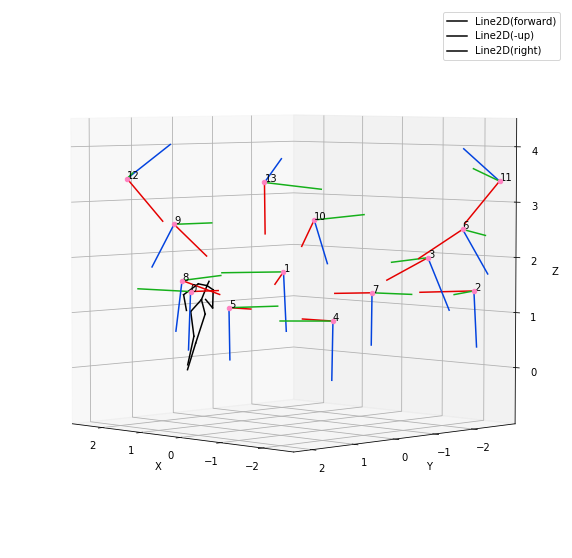

In [414]:
plot_all_camera_pos(torch.from_numpy(camera_transformation_matrix).float(), poses_3d_gt[1000,:,:])

In [415]:
save_poses(poses_3d_gt, new_dataset_loc)

## Checking projections

In [421]:
def form_intrinsics_matrix(intrinsics):
    intrinsics_matrix = torch.zeros(intrinsics.shape[0], 3,3)
    for cam_index in range(intrinsics.shape[0]):
        focal_length = intrinsics[cam_index, 0]
        px = intrinsics[cam_index, 1]
        py = intrinsics[cam_index, 2]
        intrinsics_matrix[cam_index, :, :] = torch.FloatTensor([[focal_length,0,px],[0,focal_length,py],[0,0,1]])
    return intrinsics_matrix

def take_projection(projection_client, P_world, inv_transformation_matrix, intrinsics):
    intrinsics = form_intrinsics_matrix(intrinsics)
    P_world = torch.from_numpy(P_world).float()
    inv_transformation_matrix = torch.from_numpy(inv_transformation_matrix).float()
    ones_tensor = torch.ones(14, 1, 15)*1.0
    expanded_P_world = P_world.unsqueeze(0).repeat(14, 1, 1)
    flip_x_y_single = torch.eye(3)
    flip_x_y = torch.cat((flip_x_y_single, torch.zeros(3,1)), dim=1).unsqueeze(0).repeat(14,1,1)    
    projection_result = projection_client.take_batch_projection(expanded_P_world, inv_transformation_matrix, ones_tensor, intrinsics, flip_x_y)
    return projection_result

In [422]:
frame = 1000
#plot_for_all_views(dataset_loc, frame)

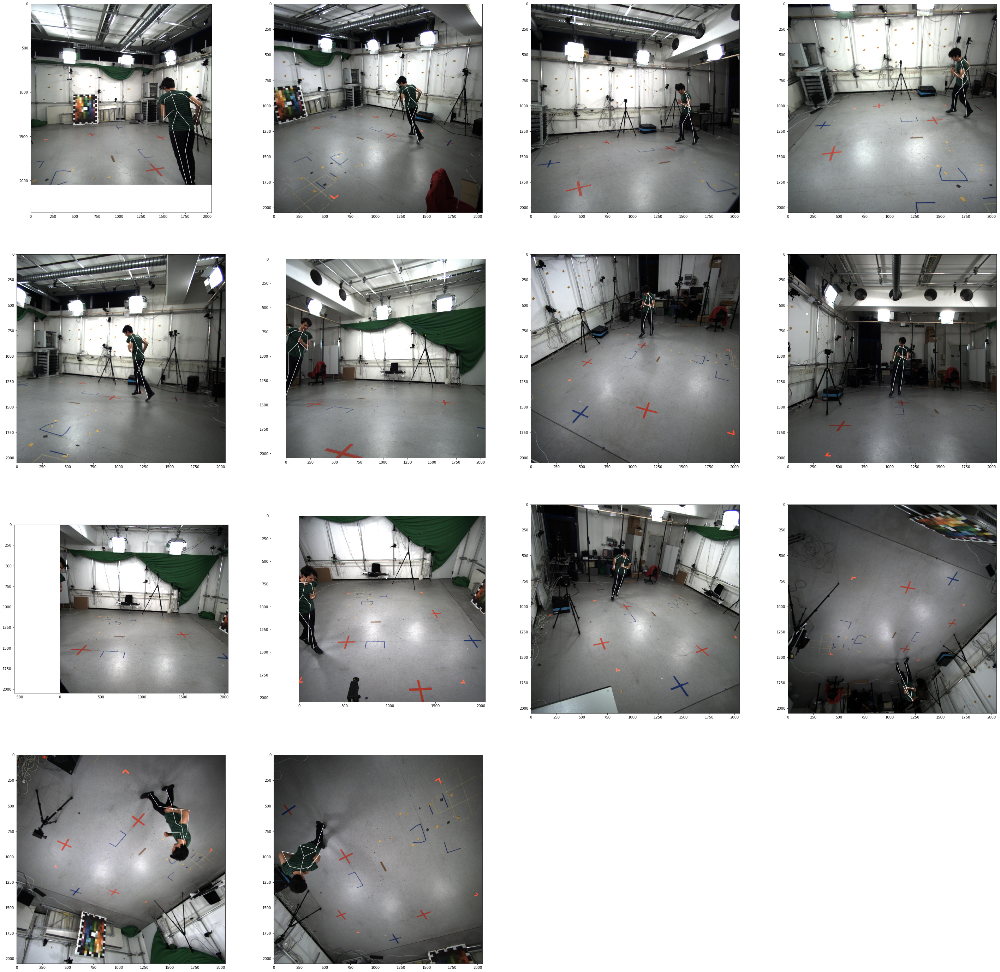

(6031, 3, 15)


In [423]:
proj = take_projection(projection_client, poses_3d_gt[frame,:,:], camera_transformation_matrix_inv, cam_intrinsics)
plot_for_all_views_proj(dataset_loc, frame, (proj).numpy())

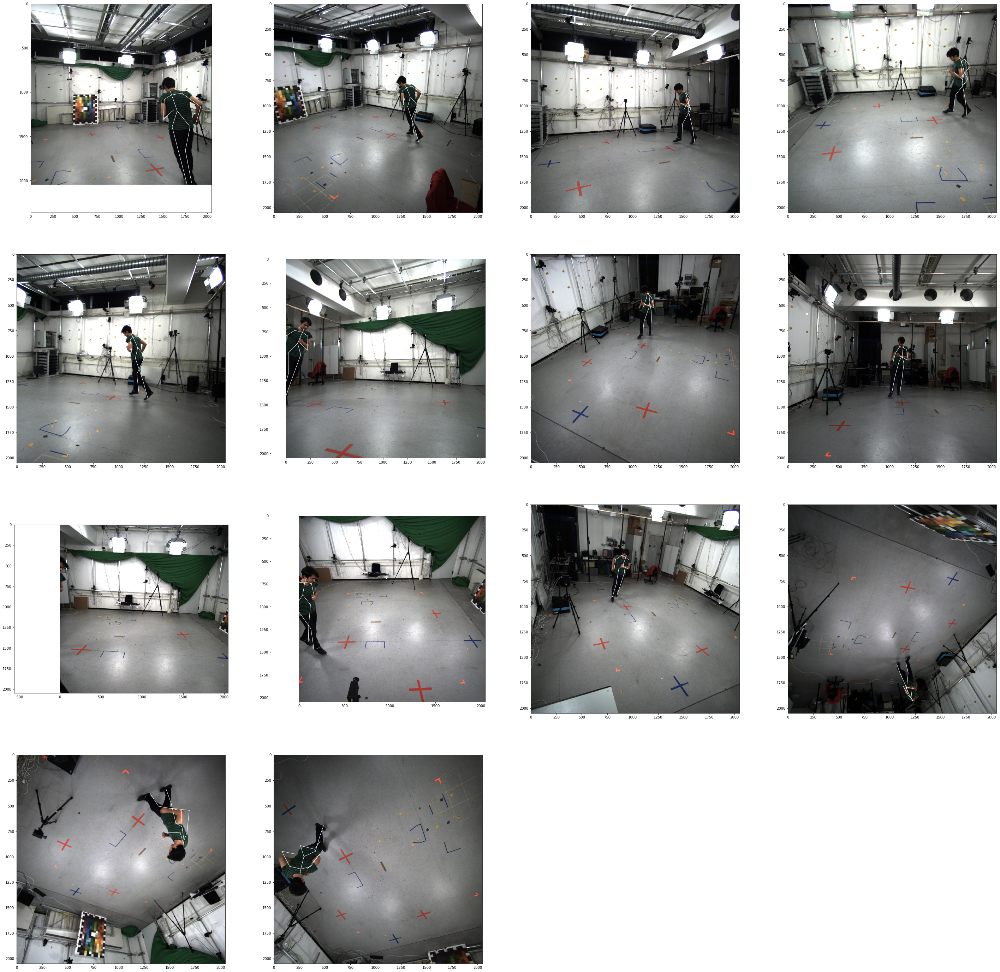

In [427]:
plot_for_all_views_proj(dataset_loc, frame+1, (proj).numpy())


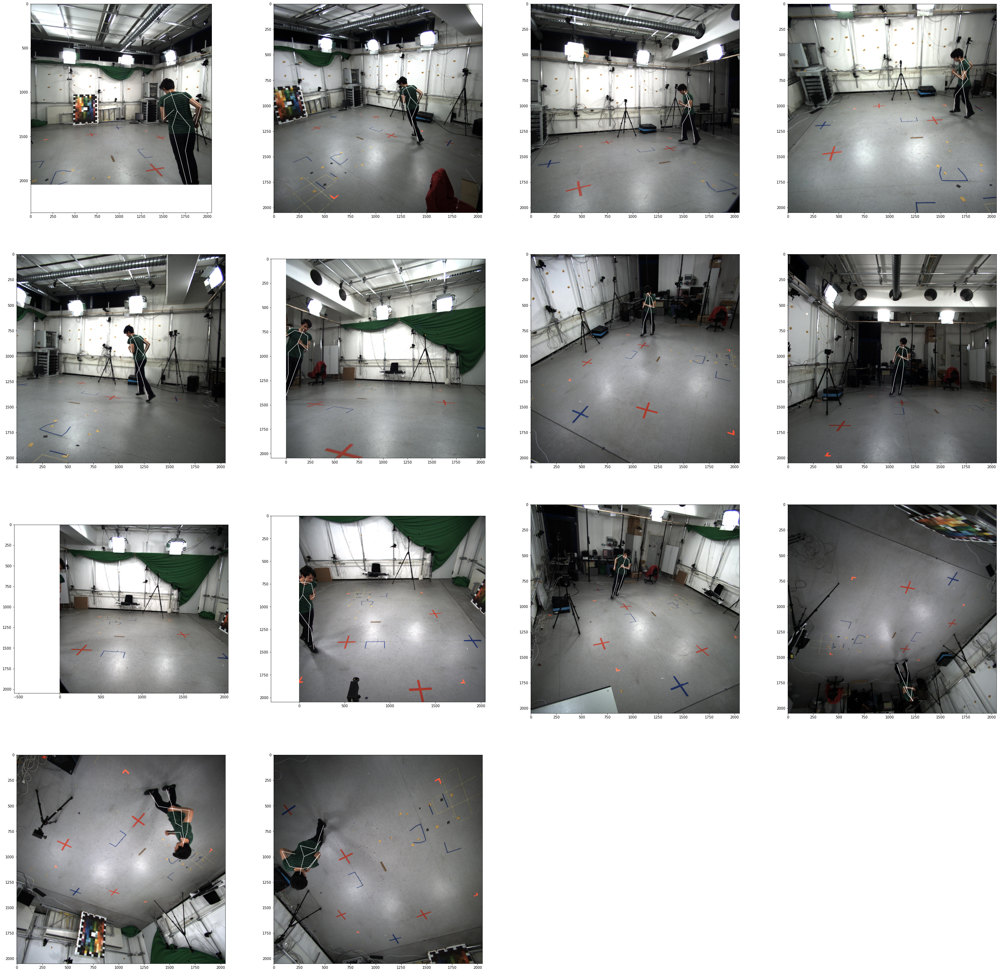

In [426]:
plot_for_all_views_proj(dataset_loc, frame-1, (proj).numpy())

